In [3]:
import csv
import os
import importlib

import pandas as pd
import numpy as np
import datetime
import matplotlib.pylab as plt
import seaborn as sns; sns.set()

import utils 
import my_transformers
import const

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.linear_model import SGDClassifier
from sklearn.linear_model import LogisticRegression

from sklearn.decomposition import PCA

from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import confusion_matrix

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

from sklearn.base import BaseEstimator, TransformerMixin

%matplotlib inline

ModuleNotFoundError: No module named 'utils'

In [18]:
importlib.reload(utils)

df = utils.PrepareData().df
df.head()

PrepareData constructor
DataFrame created from data/house_ext.csv


,id,date,price,price_bin,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,criminal_activities
0,7129300520,20141013T000000,221900.0,0,3,1.00,1180,5650,1.0,0,...,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,514
1,6414100192,20141209T000000,538000.0,0,3,2.25,2570,7242,2.0,0,...,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,502
2,5631500400,20150225T000000,180000.0,0,2,1.00,770,10000,1.0,0,...,770,0,1933,0,98028,47.7379,-122.233,2720,8062,0
3,2487200875,20141209T000000,604000.0,0,4,3.00,1960,5000,1.0,0,...,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,233
4,1954400510,20150218T000000,510000.0,0,3,2.00,1680,8080,1.0,0,...,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,0


In [5]:
importlib.reload(my_transformers)
from my_transformers import DropColumns, YearTransformer, ColumnToDateFormat, Drop33Rooms

transform_pipeline = Pipeline([
        ('yr_built_transformer', YearTransformer(column='yr_built')),
        ('33_bedrooms_row_drop', Drop33Rooms()),
        ('clean_flaw', DropColumns(columns=['id', 'date', 'yr_renovated'])),
        # ('clean_flaw', DropColumns(columns=['bathrooms'])),
        # ('clean_geodata', DropColumns(columns=['zipcode', 'lat', 'long'])),
        ('clean_duplicate', DropColumns(columns=['price'])),
     ])
ndf = transform_pipeline.transform(df)
ndf.head()

,price_bin,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,zipcode,lat,long,sqft_living15,sqft_lot15,criminal_activities
0,0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,60,98178,47.5112,-122.257,1340,5650,514
1,0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,64,98125,47.7210,-122.319,1690,7639,502
2,0,2,1.00,770,10000,1.0,0,0,3,6,770,0,82,98028,47.7379,-122.233,2720,8062,0
3,0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,50,98136,47.5208,-122.393,1360,5000,233
4,0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,28,98074,47.6168,-122.045,1800,7503,0


In [6]:
ndf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21612 entries, 0 to 21612
Data columns (total 19 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   price_bin            21612 non-null  int64  
 1   bedrooms             21612 non-null  int64  
 2   bathrooms            21612 non-null  float64
 3   sqft_living          21612 non-null  int64  
 4   sqft_lot             21612 non-null  int64  
 5   floors               21612 non-null  float64
 6   waterfront           21612 non-null  int64  
 7   view                 21612 non-null  int64  
 8   condition            21612 non-null  int64  
 9   grade                21612 non-null  int64  
 10  sqft_above           21612 non-null  int64  
 11  sqft_basement        21612 non-null  int64  
 12  yr_built             21612 non-null  int64  
 13  zipcode              21612 non-null  int64  
 14  lat                  21612 non-null  float64
 15  long                 21612 non-null 

# Logical Regression

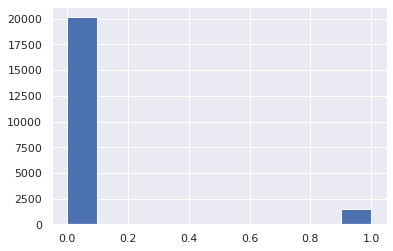

In [7]:
ndf['price_bin'].hist()

In [8]:
importlib.reload(utils)
sdf = utils.get_equal_samples(ndf, column='price_bin', mult_coef=1)
sdf['price_bin'].value_counts()

0    1834
1    1096
Name: price_bin, dtype: int64

No handles with labels found to put in legend.


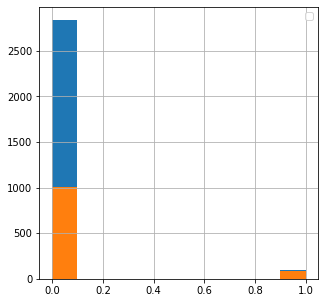

In [6]:
f, ax = plt.subplots(1, figsize=(5, 5))
sdf['waterfront'].hist(ax=ax)
sdf[sdf['price_bin']==1]['waterfront'].hist(ax=ax)
ax.legend()
plt.show()

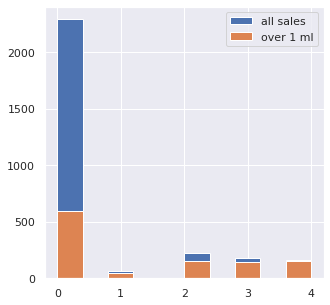

In [9]:
f, ax = plt.subplots(1, figsize=(5, 5))
sdf['view'].hist(ax=ax, label='all sales')
sdf[sdf['price_bin']==1]['view'].hist(ax=ax, label='over 1 ml')
ax.legend()
plt.show()

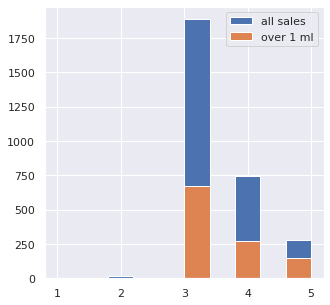

In [10]:
f, ax = plt.subplots(1, figsize=(5, 5))
sdf['condition'].hist(ax=ax, label='all sales')
sdf[sdf['price_bin']==1]['condition'].hist(ax=ax, label='over 1 ml')
ax.legend()
plt.show()

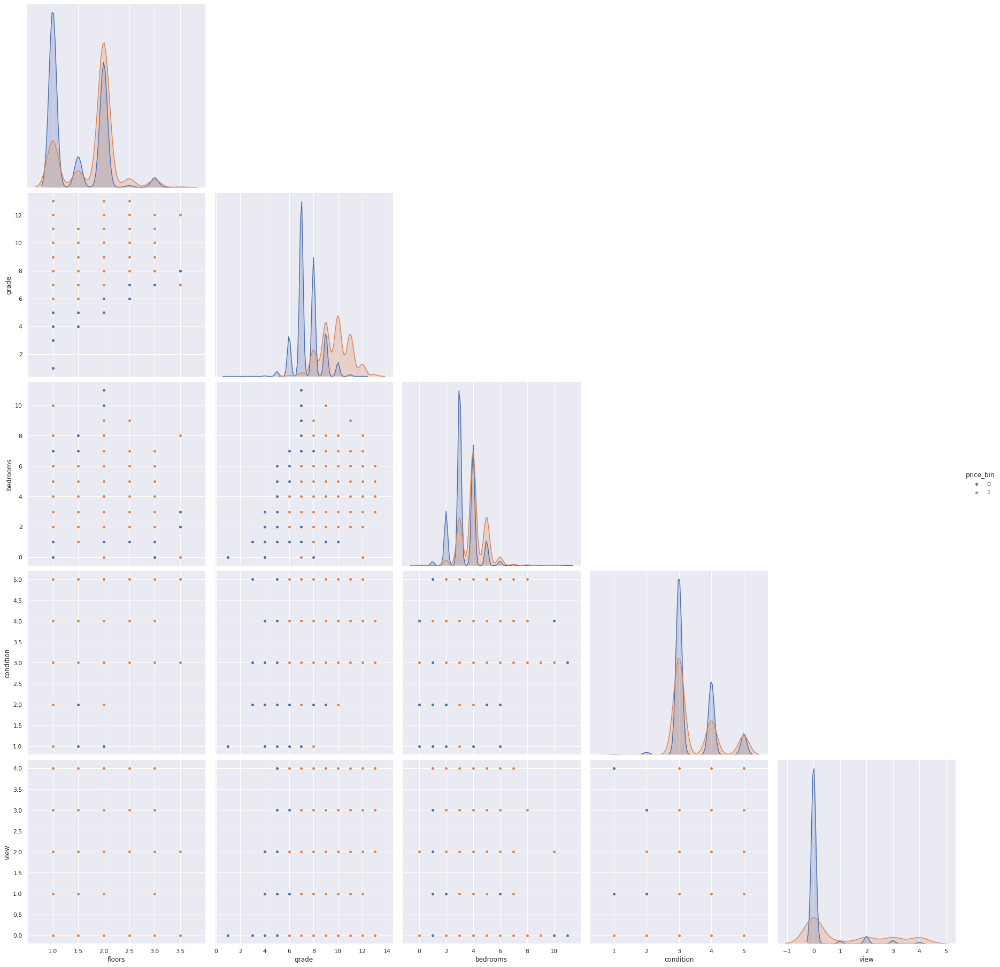

In [23]:
sns.pairplot(ndf[['floors', 'grade', 'bedrooms', 'condition', 'view', 'price_bin']], hue='price_bin', corner=True, size=5);

In [ ]:
sns.pairplot(ndf[['floors', 'grade', 'bedrooms', 'condition', 'view', 'price_bin']], hue='price_bin', corner=True, size=5);sns.pairplot(ndf[['floors', 'grade', 'bedrooms', 'condition', 'view', 'price_bin']], hue='price_bin', corner=True, size=5);

In [1]:
sdf = utils.get_equal_samples(ndf, column='price_bin', mult_coef=1)
train_X, test_X, train_y, test_y = train_test_split(
    sdf.drop(columns=['price_bin'], inplace=False), 
    sdf['price_bin'],
    test_size=const.TEST_SIZE,
    random_state=const.RANDOM_STATE
    )

' - '.join([str(getattr(v, 'shape')) for v in (train_X, test_X, train_y, test_y)])

NameError: name 'utils' is not defined

In [20]:
sgd = SGDClassifier(random_state=const.RANDOM_STATE)
sgd.fit(train_X, train_y)

SGDClassifier(random_state=111)

In [21]:
cross_val_score(sgd, train_X, train_y, cv=5, scoring='accuracy')
# sgd.predict(test_X)


array([0.94823597, 0.94274147, 0.94447658, 0.9421631 , 0.9473532 ])

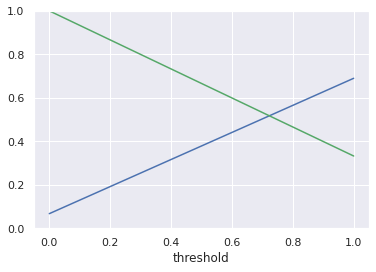

In [14]:
train_y_pred = cross_val_predict(sgd, train_X, train_y, cv=5)
precision, recall , threshold = precision_recall_curve(train_y, train_y_pred)

plt.plot(threshold, precision[:-1], 'b', label='precision')
plt.plot(threshold, recall[:-1], 'g', label='recall')
plt.xlabel('threshold')
plt.ylim(0, 1)
plt.show()


In [22]:
# lr = LogisticRegression(multi_class='multinomial',
#                         solver='lbfgs',
#                         C=8)
lr = LogisticRegression(multi_class='multinomial',
                        solver='lbfgs',
                        C=8)
lr.fit(train_X, train_y)

LogisticRegression(C=8, multi_class='multinomial')

In [23]:
train_y_pred = cross_val_predict(lr, train_X, train_y, cv=2)
confusion_matrix(train_y, train_y_pred)

array([[15952,   173],
       [  693,   471]])

In [26]:
test_y_pred = lr.predict(test_X)
confusion_matrix(test_y, test_y_pred)

array([[3959,   63],
       [ 182,  119]])

In [27]:
param_grid = {
    'multi_class': ['auto', 'ovr', 'multinomial' ],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'C': [3, 5, 8, 10, 12]
    }
grid = GridSearchCV(estimator=lr,
                    param_grid=param_grid,
                    scoring='r2',
                    verbose=1,
                    n_jobs=-1)
                    
grid_result = grid.fit(train_X, train_y)

print('Best Score: ', grid_result.best_score_)
print('Best Params: ', grid_result.best_params_)

Fitting 5 folds for each of 75 candidates, totalling 375 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    6.0s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   29.7s
[Parallel(n_jobs=-1)]: Done 375 out of 375 | elapsed:   59.4s finished
Best Score:  0.34515146394264684
Best Params:  {'C': 5, 'multi_class': 'auto', 'solver': 'newton-cg'}


# KNN

In [30]:
from sklearn import neighbors, metrics, svm
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

In [31]:
knn = neighbors.KNeighborsClassifier(n_neighbors=2, weights='uniform')
knn.fit(train_X, train_y)
predict = knn.predict(test_X)
accuracy = metrics.accuracy_score(test_y, predict)
accuracy

0.9393939393939394

In [32]:
conf_mat = confusion_matrix(test_y, predict)
conf_mat

array([[3979,   43],
       [ 219,   82]])

# SVM

In [33]:
_svm = svm.SVC()
_svm.fit(train_X, train_y)
prediction = _svm.predict(test_X)

accuracy = metrics.accuracy_score(test_y, prediction)
print("predictions:", prediction)
print("accuracy: ", accuracy)

predictions: [0 0 0 ... 0 0 0]
accuracy:  0.9303724265556327


In [34]:
conf_mat = confusion_matrix(test_y, predict)
conf_mat

array([[3979,   43],
       [ 219,   82]])

# PCA

In [44]:
ndf.columns

Index(['price_bin', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'zipcode', 'lat', 'long', 'sqft_living15',
       'sqft_lot15', 'criminal_activities'],
      dtype='object')

In [45]:
model = PCA(n_components=2)            
model.fit(train_X)                  
X_2D = model.transform(ndf.drop(columns=['price_bin'])) 

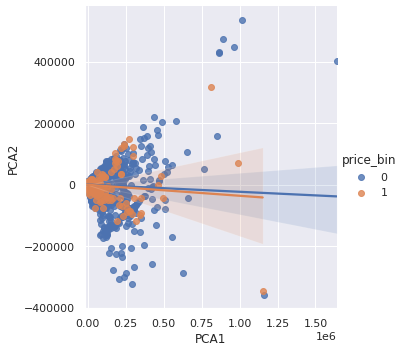

In [46]:
df_pca = ndf.copy()
df_pca['PCA1'] = X_2D[:, 0]
df_pca['PCA2'] = X_2D[:, 1]
sns.lmplot("PCA1", "PCA2", hue='price_bin', data=df_pca, fit_reg=True)

In [47]:
model = PCA(n_components=3)            
model.fit(train_X)                  
X_3D = model.transform(ndf.drop(columns=['price_bin'])) 

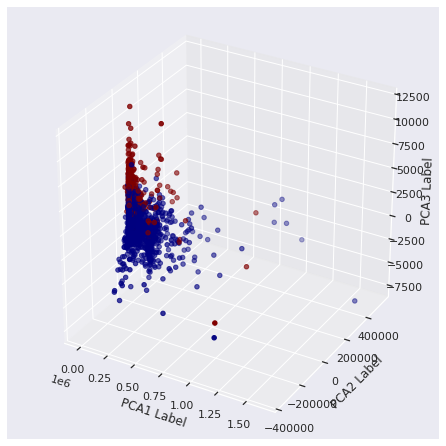

In [51]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(6,6))

ax = Axes3D(fig)

ax.scatter(df_pca['PCA1'], df_pca['PCA2'], df_pca['PCA3'], c=df_pca['price_bin'], marker='o', cmap='jet')
ax.set_xlabel('PCA1 Label')
ax.set_ylabel('PCA2 Label')
ax.set_zlabel('PCA3 Label')

plt.show()